# Modeling Formula 1 Fantasy GP points with PyMC

## Intro

Like many others I got into Formula 1 after binging through [Drive to Survive](https://en.wikipedia.org/wiki/Formula_1:_Drive_to_Survive). After enduring a nail biting (and ultimately bitterly disappointing) 2021 season, and attending the 2022 Canadian Grand Prix, I organized a small fantasy league for 2023, hosted on [Fantasy GP](https://fantasygp.com/).

Fantasy GP's rules give each player a set budget to build a team consisting of 3 drivers and 3 constructor. During the season, drivers and constructors are awarded points for position finished during at the race, as well as various bonuses such as beating their teammate and gaining positions overall. This has the effect of making even backmarker battles exciting, as they are able to generate points outside of high position finishes.

This notebook will attempt to model individual driver and constructor performance in order to provide a slightly more quantifiable basis for team construction decisions. We start by focusing on the most fundamental question - how many points per race is a given driver/constructor likely to earn. To answer it, we will create and evaluate several Bayesian models using the probabilistic programming framework [PyMC](https://www.pymc.io/welcome.html).

In [933]:
%matplotlib inline

In [934]:
import json
from enum import Enum
from pathlib import Path

import arviz as az
import preliz as pz
import numpy as np
import pandas as pd
import pymc as pm
import requests
import seaborn as sns
import tqdm
from matplotlib import pyplot as plt
from scipy import stats

In [935]:
sns.set_theme()
sns.set_style(
    style='darkgrid', 
    rc={'axes.facecolor': '.9', 'grid.color': '.8'}
)
sns.set_palette(palette='deep')
sns_c = sns.color_palette(palette='deep')

plt.rcParams['figure.figsize'] = [10, 7]

az.style.use("arviz-docgrid")

## Data aquisition

We start by acquiring data for the 2023 season. The [Ergast API](http://ergast.com/mrd/) hosts statistics for Formula 1 races from the 1950s to the present and exposes convenient endpoints for querying both [qualifying](http://ergast.com/mrd/methods/qualifying/) and [grand prix results](http://ergast.com/mrd/methods/results/).

In [936]:
API = "http://ergast.com/api/f1"

In [937]:
DATASET_PATH = {"gp": "results", "quali": "qualifying"}


def get_dataset(dataset: str, year: int, limit: int = 20000) -> dict:
    path = DATASET_PATH[dataset]
    url = f"{API}/{year}/{path}.json?limit={limit}"

    response = requests.get(url)
    response.raise_for_status()

    return response.json()


def load_dataset(dataset: str, year: int) -> dict:
    results_path = Path(f"../data/{year}_{dataset}_results.json")

    if results_path.exists():
        with results_path.open() as f:
            results = json.loads(f.read())
    else:
        results = get_dataset(dataset, year)

        with results_path.open("w") as f:
            f.write(json.dumps(results))

    return results

In [938]:
gp_data = load_dataset("gp", 2023)
quali_data = load_dataset("quali", 2023)

The data is quite nested, so first we need to unnest it into a row-wise format that Pandas can load more easily:

In [939]:
def gp_results_to_dataframe(json_data):
    data = {}
    for gp in json_data["MRData"]["RaceTable"]["Races"]:
        for result in gp["Results"]:
            data.setdefault("circuit", []).append(gp["Circuit"]["circuitId"])
            data.setdefault("driver", []).append(result["Driver"]["code"])
            data.setdefault("round", []).append(gp["round"])
            data.setdefault("constructor", []).append(
                result["Constructor"]["constructorId"]
            )

            data.setdefault("grid", []).append(result["grid"])
            data.setdefault("position", []).append(result["position"])
            data.setdefault("points", []).append(result["points"])
            data.setdefault("fastest_lap", []).append(
                result.get("FastestLap", {}).get("rank")
            )
            data.setdefault("status", []).append(result["status"])

    return (
        pd.DataFrame(data)
        .astype(
            {
                "circuit": "category",
                "driver": "category",
                "round": "int",
                "constructor": "category",
                "status": "category",
                "grid": "Int64",
                "position": "Int64",
                "points": "float32",
                "fastest_lap": "Int64",
            }
        )
        .set_index(["circuit", "driver"])
    )


def quali_results_to_dataframe(json_data):
    data = {}
    for quali in json_data["MRData"]["RaceTable"]["Races"]:
        for result in quali["QualifyingResults"]:
            data.setdefault("circuit", []).append(quali["Circuit"]["circuitId"])
            data.setdefault("driver", []).append(result["Driver"]["code"])
            data.setdefault("round", []).append(quali["round"])
            data.setdefault("constructor", []).append(
                result["Constructor"]["constructorId"]
            )

            data.setdefault("qualifying_position", []).append(result["position"])

    return (
        pd.DataFrame(data)
        .astype(
            {
                "circuit": "category",
                "driver": "category",
                "round": "int",
                "constructor": "category",
                "qualifying_position": "Int64",
            }
        )
        .set_index(["circuit", "driver"])
    )

In [940]:
gp_df = gp_results_to_dataframe(gp_data)
gp_df

round   constructor  grid  position  points  fastest_lap  \
circuit driver                                                             
bahrain VER         1      red_bull     1         1    25.0            6   
        PER         1      red_bull     2         2    18.0            7   
        ALO         1  aston_martin     5         3    15.0            5   
        SAI         1       ferrari     4         4    12.0           14   
        HAM         1      mercedes     7         5    10.0           10   
...               ...           ...   ...       ...     ...          ...   
spa     RIC        12    alphatauri    19        16     0.0           15   
        SAR        12      williams    18        17     0.0            9   
        HUL        12          haas     0        18     0.0            4   
        SAI        12       ferrari     4        19     0.0           19   
        PIA        12       mclaren     5        20     0.0         <NA>   

                          status  
circuit driver                    
bahrain VER             Finished  
        PER             Finished  
        ALO             Finished  
        SAI             Finished  
        HAM             Finished  
...                          ...  
spa     RIC             Finished  
        SAR             Finished  
        HUL             Finished  
        SAI     Collision damage  
        PIA     Collision damage  

[240 rows x 7 columns]

In [941]:
quali_df = quali_results_to_dataframe(quali_data)
quali_df

round   constructor  qualifying_position
circuit driver                                          
bahrain VER         1      red_bull                    1
        PER         1      red_bull                    2
        LEC         1       ferrari                    3
        SAI         1       ferrari                    4
        ALO         1  aston_martin                    5
...               ...           ...                  ...
spa     ALB        12      williams                   16
        ZHO        12          alfa                   17
        SAR        12      williams                   18
        RIC        12    alphatauri                   19
        HUL        12          haas                   20

[240 rows x 3 columns]

Finally, we join the grand prix and qualifying dataframes together, forming the base dataset for our analysis:

In [942]:
data_df = gp_df.join(quali_df[["qualifying_position"]])
data_df

round   constructor  grid  position  points  fastest_lap  \
circuit driver                                                             
bahrain VER         1      red_bull     1         1    25.0            6   
        PER         1      red_bull     2         2    18.0            7   
        ALO         1  aston_martin     5         3    15.0            5   
        SAI         1       ferrari     4         4    12.0           14   
        HAM         1      mercedes     7         5    10.0           10   
...               ...           ...   ...       ...     ...          ...   
spa     RIC        12    alphatauri    19        16     0.0           15   
        SAR        12      williams    18        17     0.0            9   
        HUL        12          haas     0        18     0.0            4   
        SAI        12       ferrari     4        19     0.0           19   
        PIA        12       mclaren     5        20     0.0         <NA>   

                          status  qualifying_position  
circuit driver                                         
bahrain VER             Finished                    1  
        PER             Finished                    2  
        ALO             Finished                    5  
        SAI             Finished                    4  
        HAM             Finished                    7  
...                          ...                  ...  
spa     RIC             Finished                   19  
        SAR             Finished                   18  
        HUL             Finished                   20  
        SAI     Collision damage                    5  
        PIA     Collision damage                    6  

[240 rows x 8 columns]

## Fantasy Points

Fantasy GP points per team/driver are [calculated in the following way](https://fantasygp.com/about/guide/):
* drivers earn the points scored during the grand prix, 10pts for taking pole position, 2pts per position gained on Sunday, and 5 points each for beating their teammate during qualifying and the race itself.
* constructors earn the points scored by each of their drivers during the grand prix, 1pt per position gained per driver, 5 points if both cars finish, 2 if only one car finishes.

To simplify the problem, we completely ignore sprint races (as should everyone).

From the dataframe above, the race finish status classification appears to have fairly detailed categories:

In [918]:
data_df["status"].dtype

CategoricalDtype(categories=['+1 Lap', '+2 Laps', 'Accident', 'Brakes', 'Collision',
                  'Collision damage', 'Electrical', 'Engine', 'Finished',
                  'Mechanical', 'Oil leak', 'Overheating', 'Power loss',
                  'Retired'],
, ordered=False)

Fantasy GP scoring only cares whether a car finished or not, so we define the following set of categories to indiciate a finish:

In [943]:
STATUS_FINISHED = ["Finished", "+1 Lap", "+2 Laps"]

While our dataset has the points scored per driver/constructor already, positions gained and performance vs. teammate need to be added in:

In [944]:
def add_scoring_cols(df: pd.DataFrame) -> pd.DataFrame:
    return df.assign(
        # Grid value of 0 indicates pit lane start; here we set that to 99
        # to simplify the check for who won out in qualifying.
        grid=lambda x: x["grid"].where(x["grid"] != 0, 20)
    ).assign(
        # Positions gained compared to the starting grid position; scoring doesn't
        # care about positions lost, so we set anything below 0 to 0.
        positions_gained=lambda x: np.maximum(x["grid"] - x["position"], 0),
        # Whether the driver won pole position
        has_pole=lambda x: x["qualifying_position"] == 1,
        # Whether the driver beat their teammate in qualifying
        beat_teammate_quali=lambda x: x.groupby(
            # Each group is per race, per constructor, so only 2 rows - one for each driver.
            ["circuit", "constructor"],
            group_keys=False,
        ).apply(
            # Smaller grid pos. = better; the grid position is compared
            # to the reversed grid array in the group (essentially
            # we create a cartesian product of the grid pos.)
            lambda g: g["grid"]
            < g["grid"].iloc[::-1].values
        ),
        # Same as the previous column, but for finishing position in the race.
        beat_teammate_race=lambda x: x.groupby(
            ["circuit", "constructor"], group_keys=False
        ).apply(
            lambda g: (g["position"] < g["position"].iloc[::-1].values)
            & g["status"].isin(STATUS_FINISHED)
        ),
        has_fastest_lap=lambda x: x["fastest_lap"] == 1,
    )


data_df = add_scoring_cols(data_df)

This leaves us with the following dataframe:

In [945]:
data_df[
    [
        "grid",
        "positions_gained",
        "beat_teammate_quali",
        "beat_teammate_race",
        "has_pole",
        "has_fastest_lap",
    ]
]

grid  positions_gained  beat_teammate_quali  \
circuit driver                                                
bahrain VER        1                 0                 True   
        PER        2                 0                False   
        ALO        5                 2                 True   
        SAI        4                 0                False   
        HAM        7                 2                False   
...              ...               ...                  ...   
spa     RIC       19                 3                False   
        SAR       18                 1                False   
        HUL       20                 2                False   
        SAI        4                 0                False   
        PIA        5                 0                 True   

                beat_teammate_race  has_pole  has_fastest_lap  
circuit driver                                                 
bahrain VER                   True      True            False  
        PER                  False     False            False  
        ALO                   True     False            False  
        SAI                   True     False            False  
        HAM                   True     False            False  
...                            ...       ...              ...  
spa     RIC                  False     False            False  
        SAR                  False     False            False  
        HUL                  False     False            False  
        SAI                  False     False            False  
        PIA                  False     False             <NA>  

[240 rows x 6 columns]

Finally, we can score the Fantasy GP points per the rules definition:

In [946]:
def score_constructor(x):
    finished = x["status"].isin(STATUS_FINISHED)
    match finished.sum():
        case 2:
            finish_bonus = 5
        case 1:
            finish_bonus = 2
        case _:
            finish_bonus = 0

    return x["points"].sum() + x[finished]["positions_gained"].sum() + finish_bonus


def score_driver(x):
    return pd.Series(
        x["points"]
        + x["has_pole"] * 10
        + x["positions_gained"] * 2
        + x["beat_teammate_quali"] * 5
        + x["beat_teammate_race"] * 5,
        dtype=float,
    ).where(x["status"].isin(STATUS_FINISHED), 0)

In [947]:
def score_fantasy_points(df: pd.DataFrame) -> pd.DataFrame:
    return df.assign(
        driver_points=score_driver,
        # Constructor points need to be joined back in on the grouping columns, in order to
        # fill in the missing spots with duplicate values - since we have 20 drivers, but 10 constructors,
        # the group has fewer rows and needs to be broadcast per group on the index.
        constructor_points=lambda x: x.join(
            x.groupby(["circuit", "constructor"])
            .apply(score_constructor)
            .rename("constructor_points"),
            on=["circuit", "constructor"],
        )["constructor_points"],
    )


data_df = score_fantasy_points(data_df)
data_df[["driver_points", "constructor_points"]]

driver_points  constructor_points
circuit driver                                   
bahrain VER              45.0                48.0
        PER              18.0                48.0
        ALO              29.0                32.0
        SAI              17.0                14.0
        HAM              19.0                23.0
...                       ...                 ...
spa     RIC               6.0                10.0
        SAR               2.0                 7.0
        HUL               4.0                 8.0
        SAI               0.0                17.0
        PIA               0.0                 8.0

[240 rows x 2 columns]

Note that constructor points are duplicated, since we broadcast the constructor's points across both drivers in a given race.

We repeat this whole process once again for the 2022 season, which was the first season with the new ground effect aero regulations - we will use that data to inform our prior.

In [948]:
last_season_gp_data = load_dataset("gp", 2022)
last_season_quali_data = load_dataset("quali", 2022)

last_season_df = gp_results_to_dataframe(last_season_gp_data).join(
    quali_results_to_dataframe(last_season_quali_data)[["qualifying_position"]]
)

last_season_df = add_scoring_cols(last_season_df)
last_season_df = score_fantasy_points(last_season_df)

## Data Exploration

Now we visualize the data to get a better idea of its properties. First, some basic box plots for each driver/constructor:

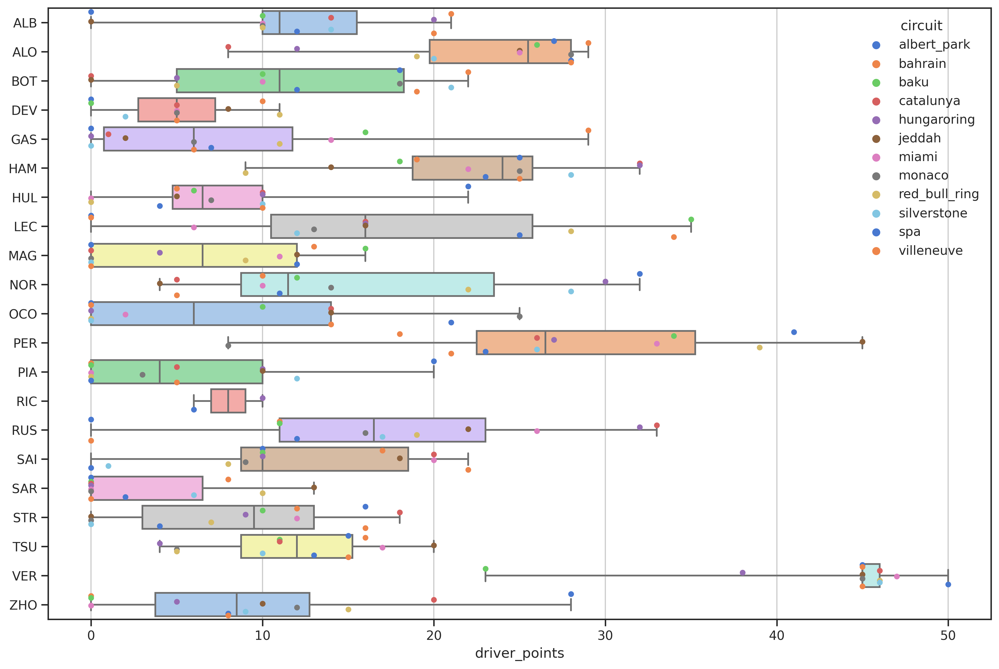

In [949]:
sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(12, 8))
sns.boxplot(
    data=data_df.reset_index(),
    x="driver_points",
    y="driver",
    palette="pastel",
    whis=[0, 100],
)

sns.stripplot(
    x="driver_points",
    y="driver",
    data=data_df.reset_index(),
    hue="circuit",
    linewidth=0,
    size=5,
    dodge=True,
    palette="muted",
)

ax.xaxis.grid(True)
ax.set(ylabel="");

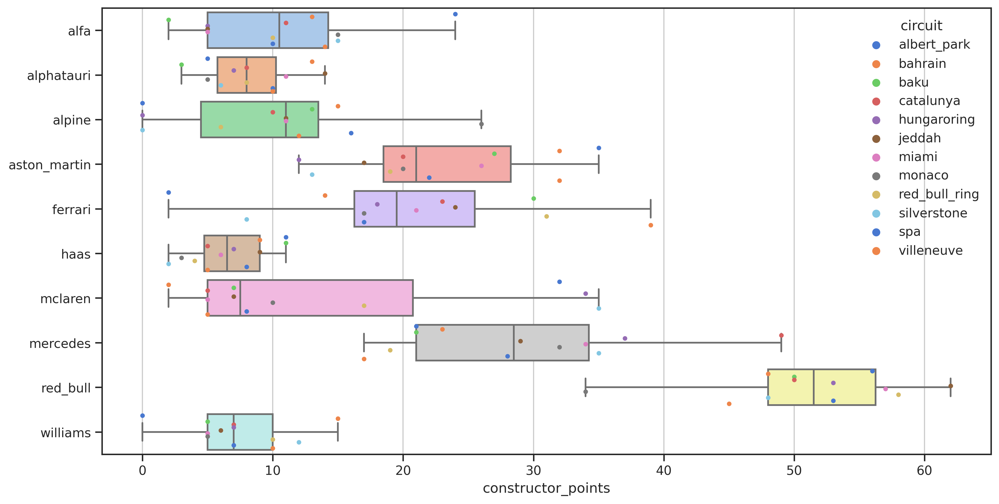

In [950]:
team_df = data_df.groupby(["circuit", "constructor"]).first().reset_index()

sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(12, 6))
sns.boxplot(
    data=team_df.reset_index(),
    x="constructor_points",
    y="constructor",
    palette="pastel",
    whis=[0, 100],
)

sns.stripplot(
    x="constructor_points",
    y="constructor",
    data=team_df.reset_index(),
    hue="circuit",
    palette="muted",
    linewidth=0,
    size=4,
    dodge=True,
)

ax.xaxis.grid(True)
ax.set(ylabel="");

These look quite similar and expose the brutal reality of Red Bull's total dominance over the field during the 2023 season. Note that drivers appear to have wider variance in points scored, comapred to teams, with the exception of Max Verstappen and his absurd consistency.

Next, we plot the kernel density estimate of the driver points to gain a better idea of the overall distribution:

In [951]:
sns.displot(
    data_df.reset_index(),
    x="driver_points",
    col="driver",
    kind="kde",
    rug=True,
    col_wrap=4,
    fill=True,
);

/home/kiril/.local/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/home/kiril/.local/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


/home/kiril/.local/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/home/kiril/.local/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


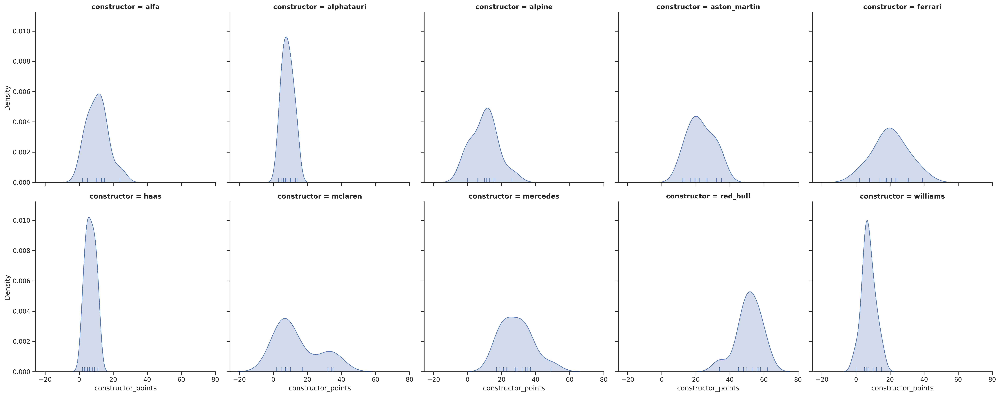

In [952]:
sns.displot(
    team_df.reset_index(),
    x="constructor_points",
    col="constructor",
    col_wrap=5,
    kind="kde",
    rug=True,
    fill=True,
);

The distribution of points is spread and somewhat bimodal in both cases, though constructors appear score in a much more consistent range compared to drivers, which agrees with our box plots. The pooled observed points distributions are:

/tmp/ipykernel_18657/55278202.py:16: UserWarning: The figure layout has changed to tight
  f.tight_layout();


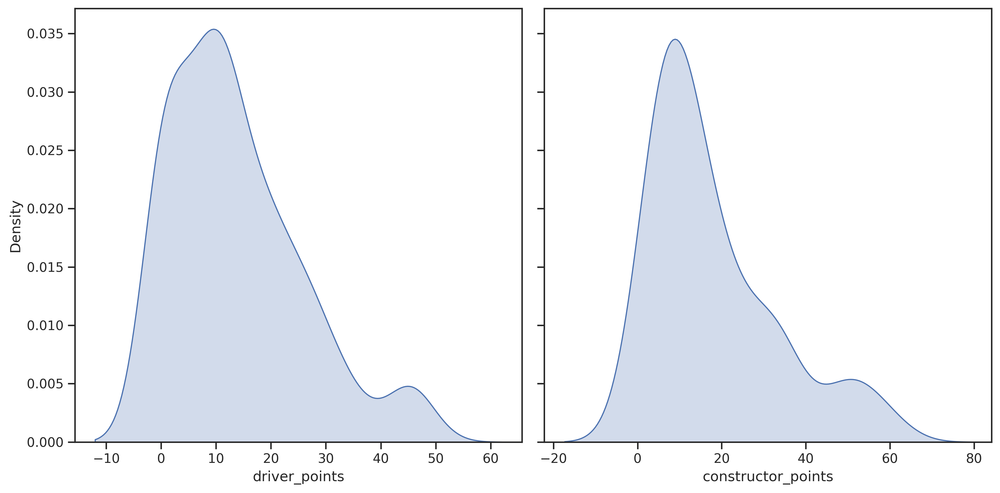

In [960]:
f, axs = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

sns.kdeplot(
    data_df.reset_index(),
    x="driver_points",
    fill=True,
    ax=axs[0]
)
sns.kdeplot(
    team_df.reset_index(),
    x="constructor_points",
    fill=True,
    ax=axs[1]
)

f.tight_layout();

Given that the point distributions between drivers and constructors appear very similar, we'll focus on constructing models of the driver points, which we can later fit to the constructor data with minor adjustments.

## Modeling with PyMC

### Unpooled model

Our first model will be the simplest possible - we just directly estimate the mean points for each driver using only that driver's 2023 data.

#### Choosing the likelihood

The points data has several properties that stem from the Fantasy GP ruleset:
- points are discrete
- points are strictly bound between 0 and 84 (25 for p1 + 1 for fastest lap + 10 for pole position + 10 for beating teammate + 19 * 2 for maximum possible positions gained)
- most drivers have a few 0 point finishes, but overall it's very unlikely for a driver to score 0 points consistently.

Because we are modeling discrete, strictly positive points, one of the count distributions is likely an appropriate choice for the likelihood. The Poisson distribution would be a valid initial choice, but the observedations appears overdispersed, as measured by the [coefficient of dispersion](https://en.wikipedia.org/wiki/Index_of_dispersion):

In [961]:
data_df = data_df.reset_index()

In [962]:
dispersion = (
    data_df.groupby("driver")["driver_points"].var()
    / data_df.groupby("driver")["driver_points"].mean()
)
dispersion

driver
ALB     4.025145
ALO     2.042645
BOT     5.412987
DEV     2.808279
GAS     9.897233
HAM     2.072193
HUL     4.595506
LEC     8.359566
MAG     6.190083
NOR     6.725782
OCO    10.087273
PER     3.905892
PIA     7.567832
RIC     1.000000
RUS     6.934217
SAI     4.445768
SAR     6.888112
STR     4.916084
TSU     2.240717
VER     1.120049
ZHO     7.445850
Name: driver_points, dtype: float64

Given that, we will pick the Negative Binomial as our likelihood, since it handles overdispersion better.

#### Choosing the priors


A Negative Binomial likelihood is defined by two parameters - its mean μ, and a shape parameter α. The mean can directly be interpreted as the mean points, while the shape parameter dictates the distribution's dispersion, so it can be seen as driver consistency. We'll need to set priors on both.

The mean is restricted to be positive only. The standard way of defining a negative binomial linear model sets a Normal prior on the mean and uses an exponential inverse link function to make it positive and usable for parameterizing the likelihood. For the actual prior parameters it would be reasonable to go with a fairly uninformative prior, such as `Normal(mu=0, sigma=1)`; in this case, prior knowledge and the ruleset gives a hunch that we can reasonably expect most drivers' mean points per race to be somewhere between 5 (backmarker, occasionally beats their teammate, maybe gains a place) and 30 (top driver & team, consistently getting and winning from pole position). To come up with parameter values for this, we use the [PreliZ](https://preliz.readthedocs.io/en/latest/) library to find a maximum entropy Normal distribution with 95% of its mass between 5 and 30 (we take the natural log of those, given the exponential inverse link):

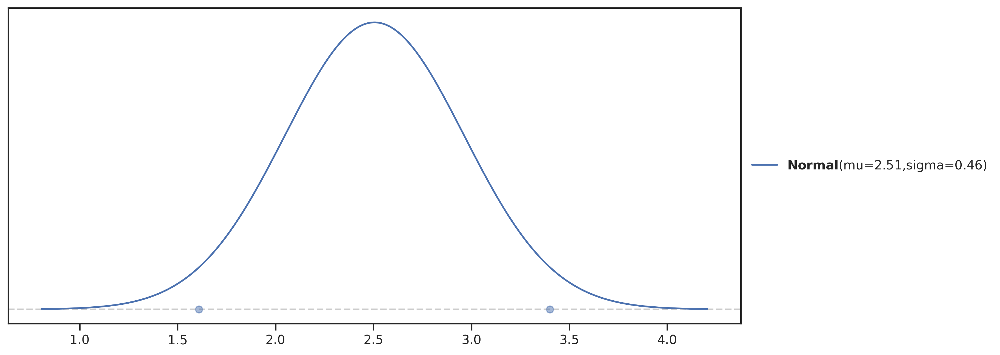

In [963]:
pz.maxent(pz.Normal(), np.log(5), np.log(30), 0.95);

The shape parameter α is also strictly positive. Its effect on the likelihood can be best understood by plotting a Negative Binomial for a few different values, while keeping the mean fixed:

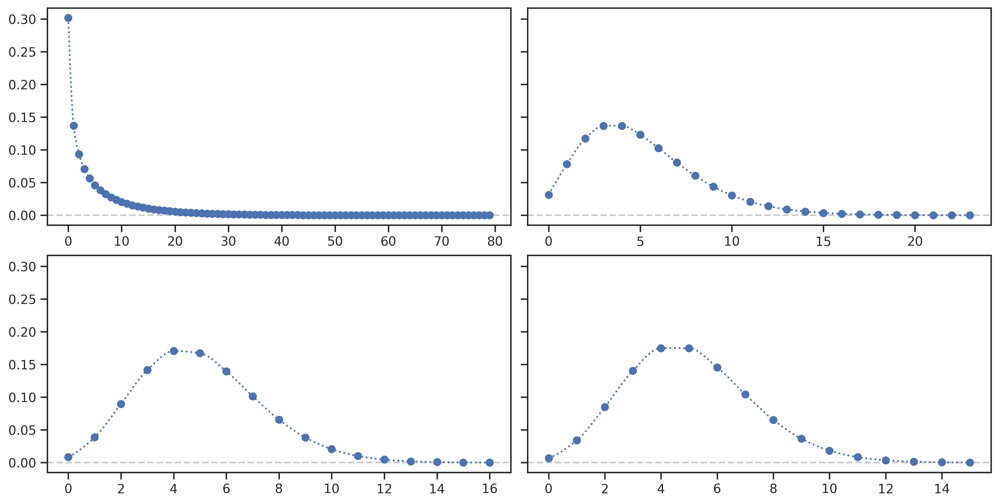

In [989]:
f, axs = plt.subplots(2, 2, figsize=(12, 6), sharey=True)

pz.NegativeBinomial(alpha=.5, mu=15).plot_pdf(ax=axs[0, 0], legend=False);
pz.NegativeBinomial(alpha=5, mu=15).plot_pdf(ax=axs[0, 1], legend=False);
pz.NegativeBinomial(alpha=50, mu=15).plot_pdf(ax=axs[1, 0], legend=False);
pz.NegativeBinomial(alpha=500, mu=15).plot_pdf(ax=axs[1, 1], legend=False);

As α increases, the tails shrink. We don't want too high values, as that will restrict the tails too much, but too small values result in absurdly long tails. To handle that, we use a trick of shifting the results of an Exponential distribution by 1, since very small values are not desired:

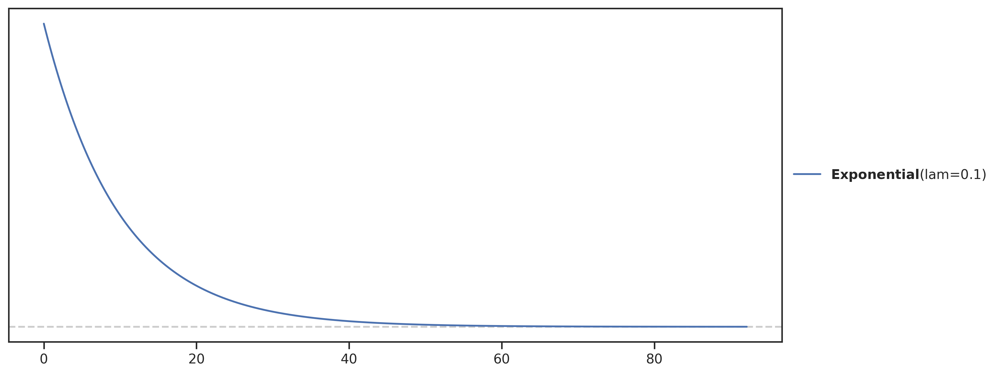

In [1003]:
pz.Exponential(1/10).plot_pdf();

Finally, we prepare the data for use within the model. The drivers column is split into a categorical variable (`labels`), and index that maps each row to the categorical id of the driver that it was recorded for:

In [1004]:
data_df = data_df.reset_index()
idx, labels = pd.factorize(data_df["driver"], sort=True)

In [1005]:
labels

CategoricalIndex(['ALB', 'ALO', 'BOT', 'DEV', 'GAS', 'HAM', 'HUL', 'LEC',
                  'MAG', 'NOR', 'OCO', 'PER', 'PIA', 'RIC', 'RUS', 'SAI',
                  'SAR', 'STR', 'TSU', 'VER', 'ZHO'],
                 categories=['ALB', 'ALO', 'BOT', 'DEV', ..., 'STR', 'TSU', 'VER', 'ZHO'], ordered=False, dtype='category')

In [1006]:
idx

array([19, 11,  1, 15,  5, 17, 14,  2,  4,  0, 18, 16,  8,  3,  6, 20,  9,
       10,  7, 12, 11, 19,  1, 14,  5, 15,  7, 10,  4,  8, 18,  6, 20,  3,
       12, 16,  9,  2,  0, 17, 19,  5,  1, 17, 11,  9,  6, 12, 20, 18,  2,
       15,  4, 10,  3, 16,  8, 14,  0,  7, 11, 19,  7,  1, 15,  5, 17, 14,
        9, 18, 12,  0,  8,  4, 10, 16,  6,  2, 20,  3, 19, 11,  1, 14, 15,
        5,  7,  4, 10,  8, 18, 17,  2,  0,  6, 20,  9,  3, 12, 16, 19,  1,
       10,  5, 14,  7,  4, 15,  9, 12,  2,  3, 20,  0, 18, 11,  6, 16,  8,
       17, 19,  5, 14, 11, 15, 17,  1, 10, 20,  4,  7, 18, 12,  3,  6,  0,
        9,  8,  2, 16, 19,  1,  5,  7, 15, 11,  0, 10, 17,  2, 12,  4,  9,
       18,  6, 20,  8,  3, 14, 16, 19,  7, 11,  9,  1, 15, 14,  5, 17,  4,
        0, 20, 16, 10,  2, 12,  3,  8, 18,  6, 19,  9,  5, 12, 14, 11,  1,
        0,  7, 15, 16,  2,  6, 17, 20, 18,  3,  4,  8, 10, 19,  9, 11,  5,
       12, 14,  7, 15,  1, 17,  0,  2, 13,  6, 18, 20,  8, 16, 10,  4, 19,
       11,  7,  5,  1, 14

We also extract the observed points:

In [1007]:
obs = data_df["driver_points"]
obs

0      45.0
1      18.0
2      29.0
3      17.0
4      19.0
       ... 
235     6.0
236     2.0
237     4.0
238     0.0
239     0.0
Name: driver_points, Length: 240, dtype: float64

#### Model definition

Next, we define the model with `PyMC`:

In [1016]:
with pm.Model(coords={"group": labels, "idx": idx}) as unpooled_negb:
    y_data = pm.MutableData("y_data", obs)
    group_idx = pm.MutableData("group_idx", idx)

    μ = pm.Normal("μ", 2.5, .46, dims="group")
    μ_ = pm.Deterministic("μ_", pm.math.exp(μ), dims="group")

    α = pm.Exponential("α", 1/10, dims="group") + 1

    y = pm.NegativeBinomial(
        "y", alpha=α[group_idx], mu=μ_[group_idx], observed=y_data, dims="idx"
    )

To see if the choice for priors is acceptable, we sample from the prior predictive and plot the results:

In [1017]:
with unpooled_negb:
    unpooled_prior_samples = pm.sample_prior_predictive(samples=1000)

Sampling: [y, α, μ]


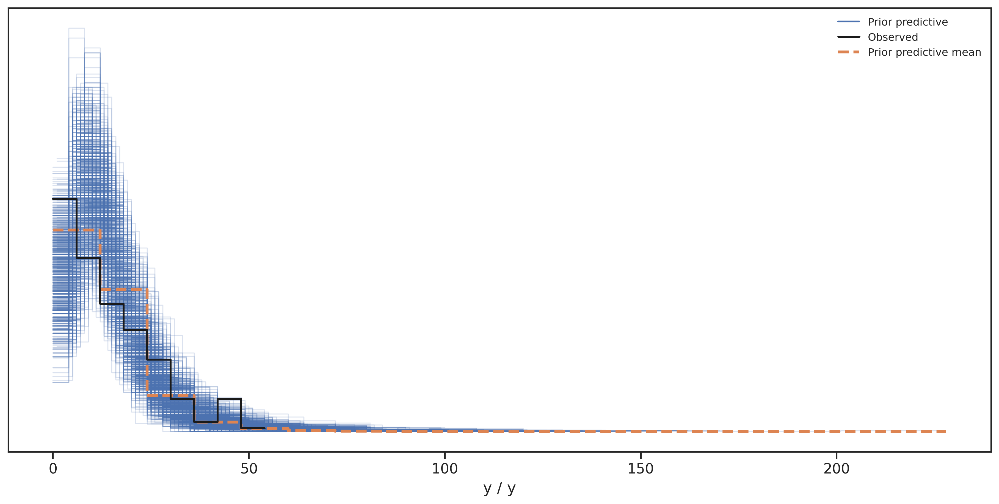

In [1018]:
az.plot_ppc(unpooled_prior_samples, group="prior", figsize=(12, 6));

The prior is quite wide, with a very long and thin tail, but overall the data could be plausibly seen as coming from it.

#### Inference and diagnostics


Next, we sample from the posterior and the posterior predictive distribution:

In [1019]:
with unpooled_negb:
    unpooled_idata = pm.sample(target_accept=0.9, idata_kwargs={"log_likelihood": True})
    pm.sample_posterior_predictive(unpooled_idata, extend_inferencedata=True)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [μ, α]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 5 seconds.
Sampling: [y]


There are no divergences detected, which is a good first sign that the model has converged.

To further validate the sampling process and model calibration, we plot:
- the [energy plot](https://python.arviz.org/en/latest/api/generated/arviz.plot_energy.html#r74895e2d4323-1) and [BFMI](https://python.arviz.org/en/latest/api/generated/arviz.bfmi.html#arviz.bfmi). For this plot, we want the marginal energy and energy transition distributions to overlap as much as possible, and for BFMI to be above .3. The results indiciate no issues with the sampling process.
- the posterior predictive distribution - visually this should be a "good fit", indicating that the model is making predictions which are in line with the data.
- the Bayesian p-value - the KDE plot and population ideal distrubution should overlap as much as possible; here we can see that the model is making predictions slightly shifted to higher values than the data would suggest, but still reasonably close.
- the u-value - the prediciton curve should look somewhat uniform. In our case, that's not true for the left portion of the distribution, which matches the shifted predictions from the p-value plot.

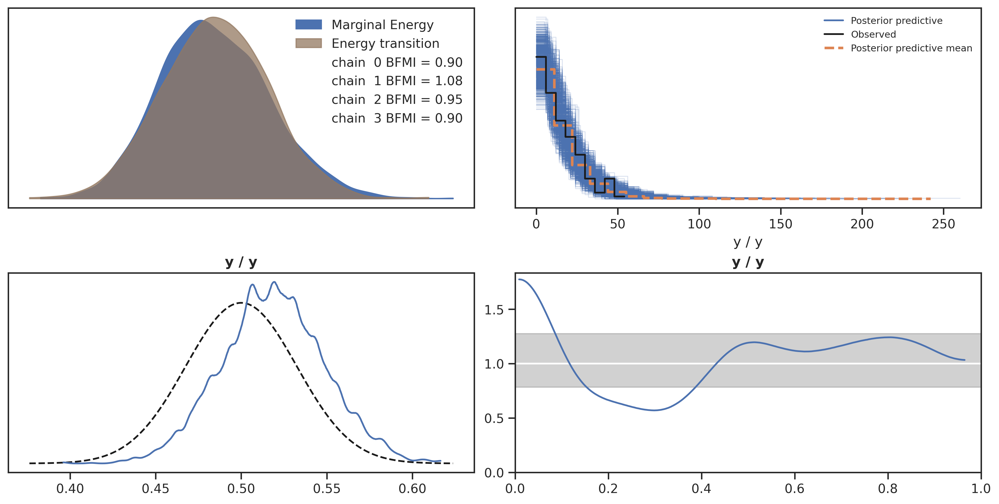

In [1022]:
_, axs = plt.subplots(2, 2, figsize=(12, 6), sharey=False)

az.plot_energy(unpooled_idata, ax=axs[0, 0])
az.plot_ppc(unpooled_idata, ax=axs[0, 1])
az.plot_bpv(unpooled_idata, kind="p_value", ax=axs[1, 0])
az.plot_bpv(unpooled_idata, kind="u_value", ax=axs[1, 1]);


Next, we check `r_hat` and effective sample size:

In [1023]:
az.summary(unpooled_idata, var_names=["μ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
μ[ALB],2.475,0.202,2.099,2.870,0.003,0.002,5793.0,2873.0,1.0
μ[ALO],3.103,0.103,2.896,3.286,0.001,0.001,5118.0,2960.0,1.0
μ[BOT],2.483,0.216,2.073,2.894,0.003,0.002,6256.0,2683.0,1.0
μ[DEV],1.830,0.240,1.404,2.309,0.003,0.003,5150.0,2279.0,1.0
μ[GAS],2.179,0.249,1.716,2.652,0.003,0.002,7305.0,3226.0,1.0
μ[HAM],3.093,0.098,2.910,3.276,0.001,0.001,6510.0,2616.0,1.0
μ[HUL],2.114,0.209,1.695,2.491,0.003,0.002,6108.0,3054.0,1.0
μ[LEC],2.765,0.210,2.361,3.152,0.003,0.002,7139.0,2906.0,1.0
μ[MAG],2.055,0.251,1.566,2.493,0.003,0.002,5947.0,2744.0,1.0
μ[NOR],2.704,0.175,2.376,3.036,0.002,0.002,5357.0,2654.0,1.0


Both tail and bulk effective sample sizes are sufficiently above what's needed to make `r_hat` a reliable measure. `r_hat` itself is at 1 for all estimated parameters, which further indicates model convergence.

Lastly, we plot the traces themselves for the μ parameter only:

/home/kiril/.local/lib/python3.11/site-packages/arviz/plots/traceplot.py:222: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (21), generating only 20 plots
  warnings.warn(


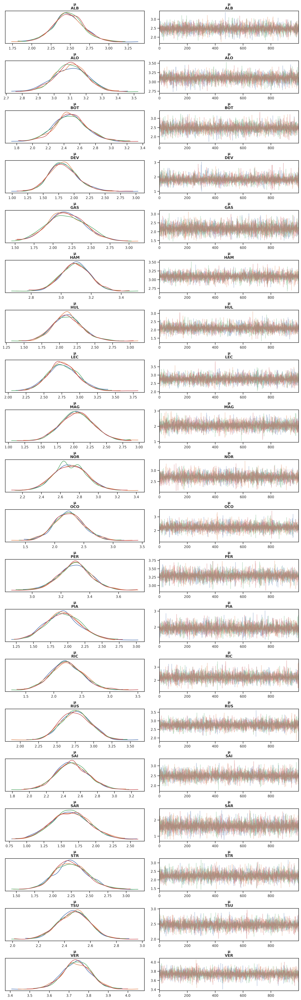

In [1024]:
az.plot_trace(unpooled_idata, var_names=["μ"], compact=False);

All chains are "noisy", and their KDES overlap strongly indicating good mixing and convergence.

#### Posterior Evaluation

We are reasonably confident that the model has converged and that there were no issues during sampling. Now it's time to check the posterior distributions of our estimated parameters. Below we plot the posterior for the exponentiated μ (μ_) parameter - that's the distribution of the mean points for each driver:

In [1025]:
az.plot_posterior(unpooled_idata, var_names=["μ_"]);

The estimates look well formed; to make comparison between drivers easier, here's a forest plot of the posterior parameter:

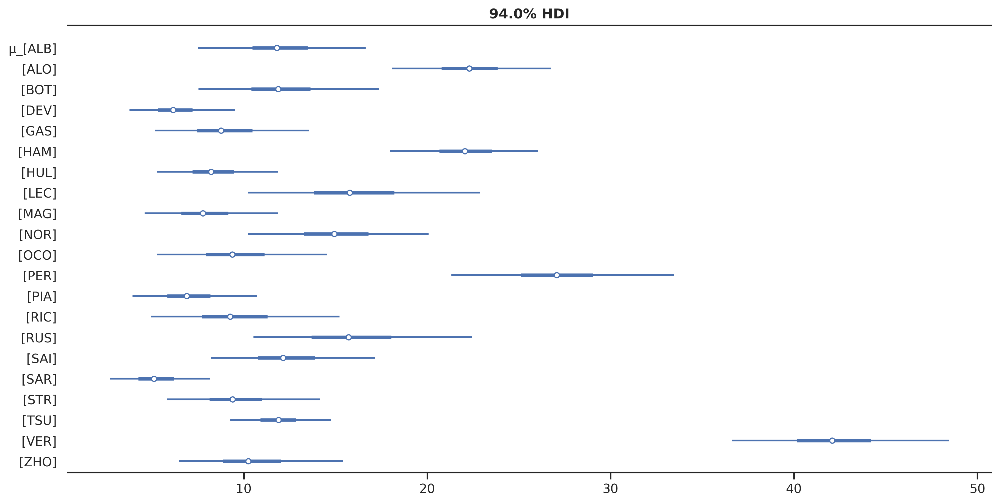

In [1026]:
az.plot_forest(unpooled_idata, var_names=["μ_"], combined=True, figsize=(12, 6));

The estimates are quite wide, but fairly in line with what we expect from each driver, given their skill and team.

As a last visual check, let's plot the posterior predictive distributions for a few individual drivers:

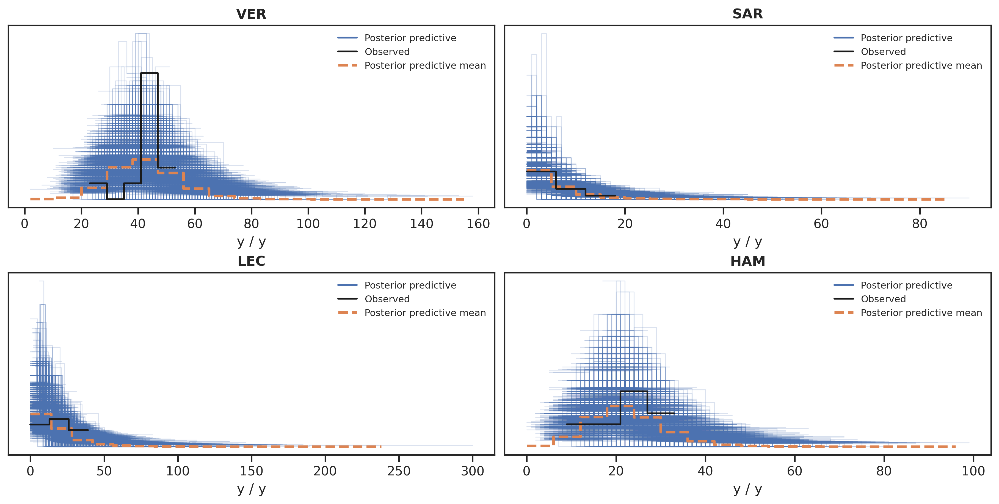

In [1035]:
fig, axs = plt.subplots(2, 2, figsize=(12, 6))

DriverIdx = Enum("Driver", zip(labels.categories, labels.codes))

az.plot_ppc(unpooled_idata, coords={"idx": [DriverIdx.VER.value]}, ax=axs[0, 0])
axs[0, 0].set_title("VER")

az.plot_ppc(unpooled_idata, coords={"idx": [DriverIdx.SAR.value]}, ax=axs[0, 1])
axs[0, 1].set_title("SAR")

az.plot_ppc(unpooled_idata, coords={"idx": [DriverIdx.LEC.value]}, ax=axs[1, 0])
axs[1, 0].set_title("LEC")

az.plot_ppc(unpooled_idata, coords={"idx": [DriverIdx.HAM.value]}, ax=axs[1, 1])
axs[1, 1].set_title("HAM");

These look like reasonable fits, but with a lot of uncertaintly, especially for Leclerc, which is not surprising.

Finally, we inspect PSIS-LOO-CV to get an idea of the performance of the model:

In [1036]:
az.loo(unpooled_idata)

Computed from 4000 posterior samples and 240 observations log-likelihood matrix.

         Estimate       SE
elpd_loo  -826.73    11.96
p_loo       35.12        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)      232   96.7%
 (0.5, 0.7]   (ok)          8    3.3%
   (0.7, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

### Zero Inflated Unpooled

One of the common issues with both Poisson and Negative Binomial models is that they do not generate 0s often enough. This can be alleviated by using a mixture model that inflates the number of zeroes, which `PyMC` already has an implementation of - the [Zero Inflated Negative Binomial likelihood](https://www.pymc.io/projects/docs/en/stable/api/distributions/generated/pymc.ZeroInflatedNegativeBinomial.html).

To verify the hunch that extra zeroes might result in a better model, we define a new model with the same priors, but using the mixture likelihood. One additional parameter, ψ, is needed, so we have to set a prior on that. ψ is the probability of a non-zero value, and as such is set between 0 and 1. We will use a Beta as the prior distribution over that, and given the ruleset and reliability of modern F1 cars, the prior belief is that 0 point finishes aren't all that likely. To express that, we take the maximum entropy Beta whose mass is concentrated between .7 and 1:

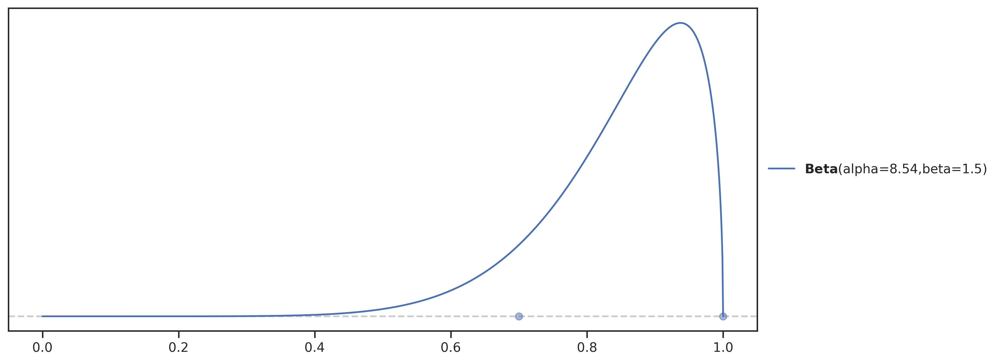

In [1039]:
pz.maxent(pz.Beta(), 0.7, 1, .9);

The new model is trivial to define:

In [1040]:
with pm.Model(coords={"group": labels, "idx": idx}) as zi_unpooled_negb:
    y_data = pm.MutableData("y_data", obs)
    group_idx = pm.MutableData("group_idx", idx)

    μ = pm.Normal("μ", 2.5, .46, dims="group")
    μ_ = pm.Deterministic("μ_", pm.math.exp(μ), dims="group")

    α = pm.Exponential("α", 1/10, dims="group") + 1
    
    ψ = pm.Beta("ψ", 8.5, 1.5, dims="group")
    
    y = pm.ZeroInflatedNegativeBinomial(
        "y", psi=ψ[group_idx], alpha=α[group_idx], mu=μ_[group_idx], observed=y_data, dims="idx"
    )

We perform the same prior predictive check:

In [1041]:
with zi_unpooled_negb:
    zi_unpooled_prior_samples = pm.sample_prior_predictive(samples=1000)

Sampling: [y, α, μ, ψ]


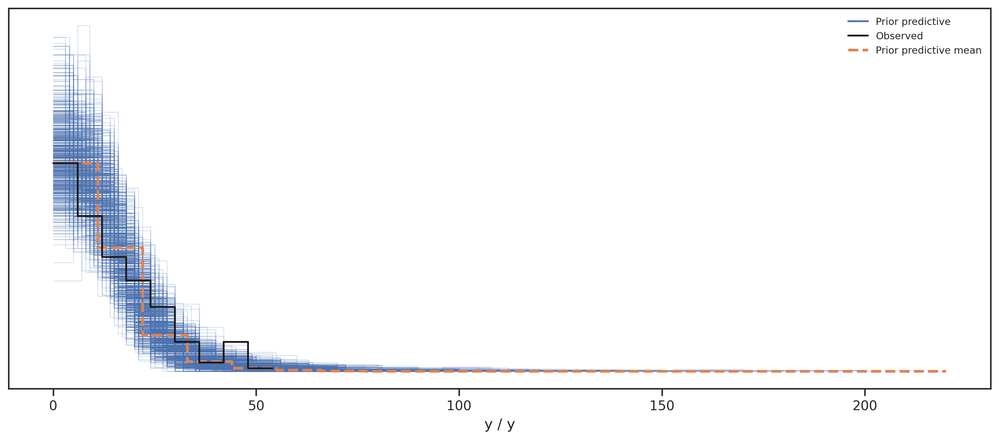

In [1043]:
az.plot_ppc(zi_unpooled_prior_samples, group="prior");

Sample:

In [1044]:
with zi_unpooled_negb:
    zi_unpooled_idata = pm.sample(target_accept=0.9, idata_kwargs={"log_likelihood": True})
    pm.sample_posterior_predictive(zi_unpooled_idata, extend_inferencedata=True)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [μ, α, ψ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 9 seconds.
Sampling: [y]


Posterior and inference checks look good as well:

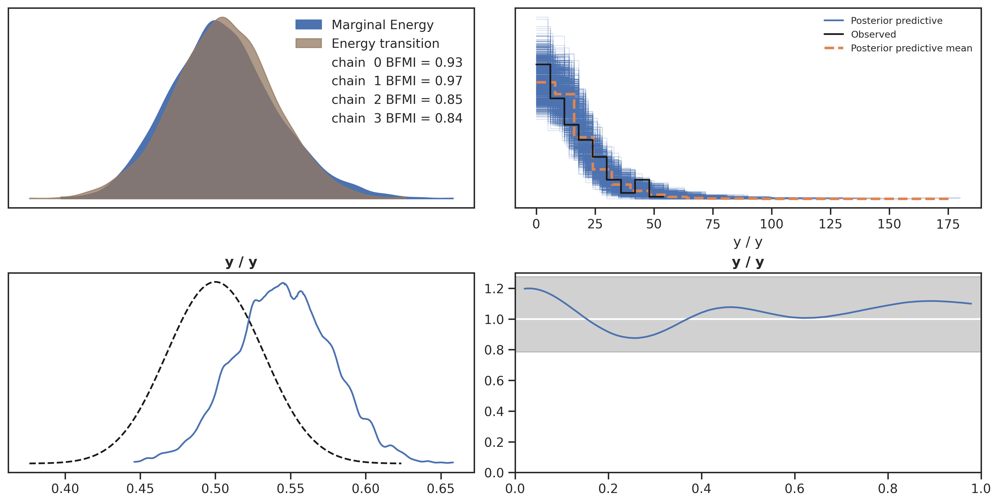

In [1045]:
_, axs = plt.subplots(2, 2, figsize=(12, 6), sharey=False)

az.plot_energy(zi_unpooled_idata, ax=axs[0, 0])
az.plot_ppc(zi_unpooled_idata, ax=axs[0, 1])
az.plot_bpv(zi_unpooled_idata, kind="p_value", ax=axs[1, 0])
az.plot_bpv(zi_unpooled_idata, kind="u_value", ax=axs[1, 1]);


/home/kiril/.local/lib/python3.11/site-packages/arviz/plots/traceplot.py:222: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (21), generating only 20 plots
  warnings.warn(


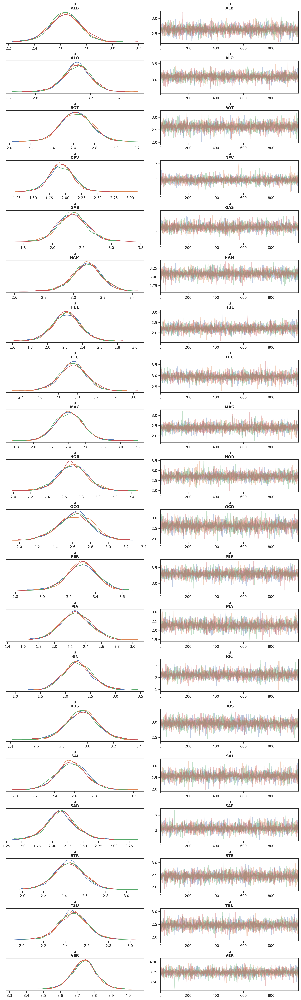

In [1046]:
az.plot_trace(zi_unpooled_idata, var_names=["μ"], compact=False);

#### Posterior Evaluation

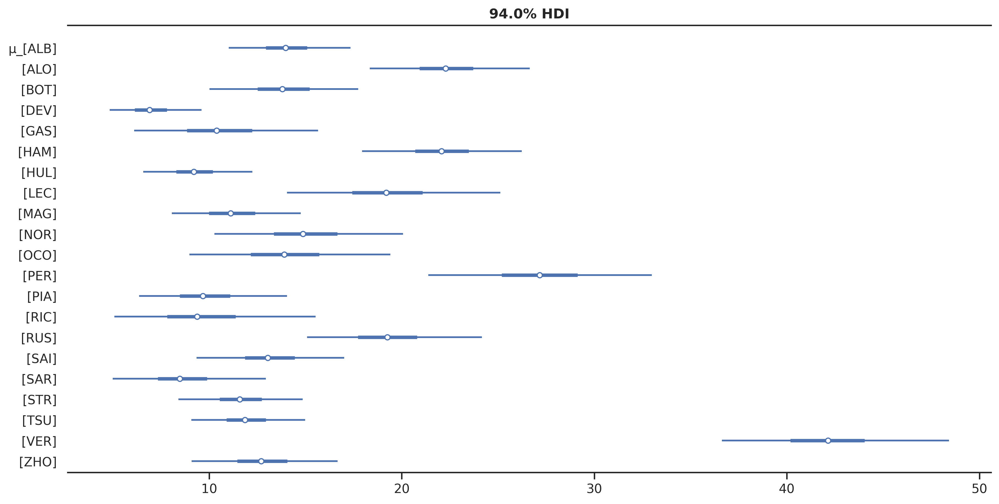

In [1047]:
az.plot_forest(zi_unpooled_idata, var_names=["μ_"], combined=True, figsize=(12, 6));

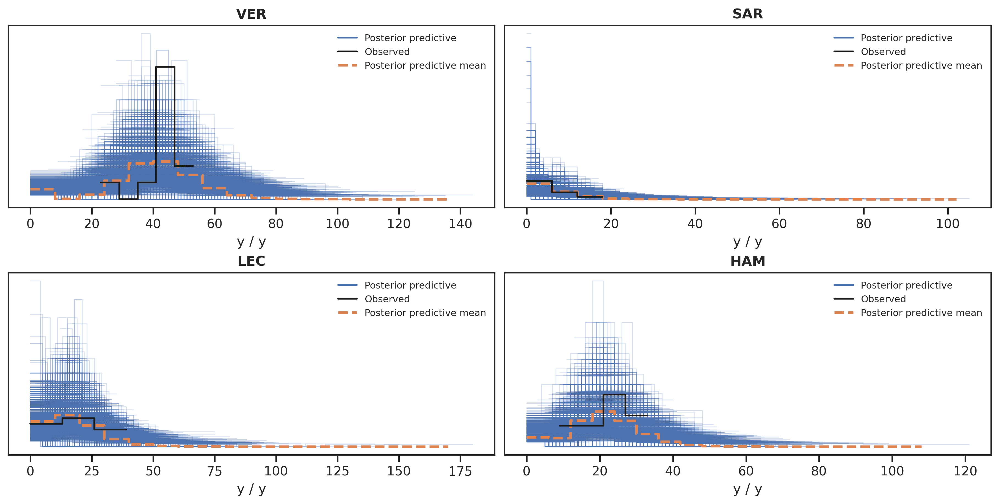

In [1048]:
fig, axs = plt.subplots(2, 2, figsize=(12, 6))

az.plot_ppc(zi_unpooled_idata, coords={"idx": [DriverIdx.VER.value]}, ax=axs[0, 0])
axs[0, 0].set_title("VER")

az.plot_ppc(zi_unpooled_idata, coords={"idx": [DriverIdx.SAR.value]}, ax=axs[0, 1])
axs[0, 1].set_title("SAR")

az.plot_ppc(zi_unpooled_idata, coords={"idx": [DriverIdx.LEC.value]}, ax=axs[1, 0])
axs[1, 0].set_title("LEC")

az.plot_ppc(zi_unpooled_idata, coords={"idx": [DriverIdx.HAM.value]}, ax=axs[1, 1])
axs[1, 1].set_title("HAM");

#### Model Comparison

Now that we have two models - basic unpooled and zero inflated unpooled - it's worth running a comparison to see which performs better. We expect the zero inflated model to be better, but the basic model also has its use as a baseline for comparison.

In [1051]:
comparison = az.compare({"unpooled": unpooled_idata, "zero inflated unpooled": zi_unpooled_idata})
comparison

/home/kiril/.local/lib/python3.11/site-packages/arviz/stats/stats.py:803: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
zero inflated unpooled,0,-771.077381,39.086031,0.000000,0.928096,16.238984,0.000000,True,log
unpooled,1,-826.725467,35.115523,55.648086,0.071904,11.964934,12.171487,False,log


In [1052]:
az.loo(zi_unpooled_idata)

/home/kiril/.local/lib/python3.11/site-packages/arviz/stats/stats.py:803: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Computed from 4000 posterior samples and 240 observations log-likelihood matrix.

         Estimate       SE
elpd_loo  -771.08    16.24
p_loo       39.09        -

There has been a warning during the calculation. Please check the results.
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)      236   98.3%
 (0.5, 0.7]   (ok)          3    1.2%
   (0.7, 1]   (bad)         1    0.4%
   (1, Inf)   (very bad)    0    0.0%

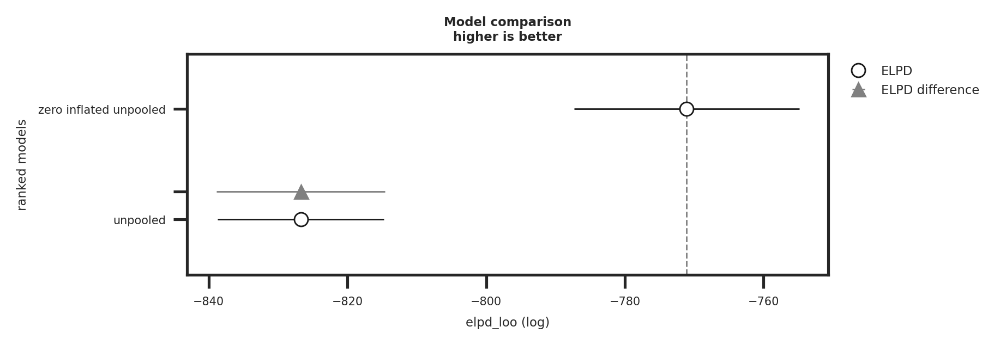

In [1055]:
az.plot_compare(comparison);

### Hierarchical partially pooled model

So far we have been modeling each driver individually. 

In [1143]:
with pm.Model(coords={"group": labels, "idx": idx}) as ml_pp_negb:
    y_data = pm.MutableData("y_data", obs)
    group_idx = pm.MutableData("group_idx", idx)

    μ_μ = pm.Normal("μ_μ", 2.5, .46)
    μ_σ = pm.HalfNormal("μ_σ", .25)

    μ = pm.Normal("μ", mu=μ_μ, sigma=μ_σ, dims="group")
    μ_ = pm.Deterministic("μ_", pm.math.exp(μ), dims="group")

    α = pm.Exponential("α", 1/10, dims="group") + 1

    ψ = pm.Beta("ψ", 8.5, 1.5, dims="group")

    y = pm.ZeroInflatedNegativeBinomial(
        "y", psi=ψ[group_idx], alpha=α[group_idx], mu=μ_[group_idx], observed=y_data, dims="idx"
    )

In [1144]:
with ml_pp_negb:
    ml_pp_negb_prior_predictive = pm.sample_prior_predictive(samples=1000)

Sampling: [y, α, μ, μ_μ, μ_σ, ψ]


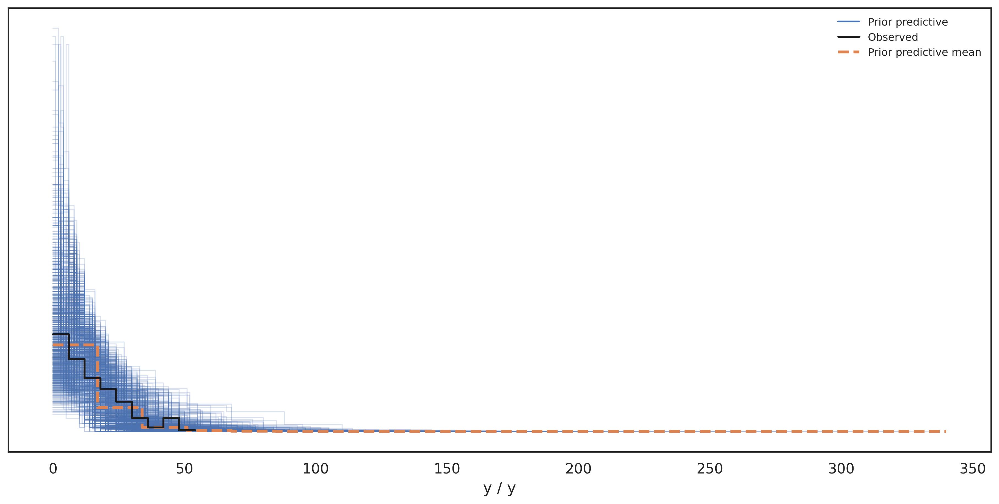

In [1145]:
az.plot_ppc(ml_pp_negb_prior_predictive, group="prior", figsize=(12, 6));

In [1146]:
with ml_pp_negb:
    ml_pp_negb_idata = pm.sample(target_accept=.9, idata_kwargs={"log_likelihood": True})
    pm.sample_posterior_predictive(ml_pp_negb_idata, extend_inferencedata=True)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [μ_μ, μ_σ, μ, α, ψ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 11 seconds.
Sampling: [y]


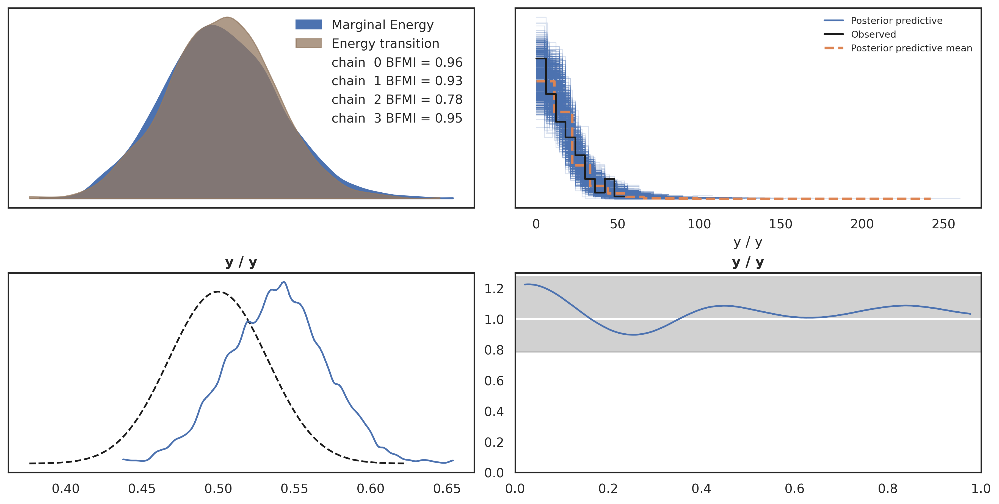

In [1147]:
_, axs = plt.subplots(2, 2, figsize=(12, 6), sharey=False)

az.plot_energy(ml_pp_negb_idata, ax=axs[0, 0])
az.plot_ppc(ml_pp_negb_idata, ax=axs[0, 1])
az.plot_bpv(ml_pp_negb_idata, kind="p_value", ax=axs[1, 0])
az.plot_bpv(ml_pp_negb_idata, kind="u_value", ax=axs[1, 1]);


In [1148]:
az.summary(ml_pp_negb_idata, var_names=["μ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
μ[ALB],2.647,0.120,2.424,2.863,0.001,0.001,7915.0,2557.0,1.0
μ[ALO],3.106,0.103,2.918,3.299,0.001,0.001,8012.0,2827.0,1.0
μ[BOT],2.643,0.153,2.362,2.935,0.002,0.001,5691.0,2860.0,1.0
μ[DEV],1.978,0.189,1.604,2.313,0.003,0.002,6071.0,2512.0,1.0
μ[GAS],2.396,0.239,1.954,2.850,0.003,0.002,8521.0,2717.0,1.0
μ[HAM],3.095,0.098,2.915,3.285,0.001,0.001,7441.0,2772.0,1.0
μ[HUL],2.250,0.164,1.934,2.547,0.002,0.002,6396.0,2776.0,1.0
μ[LEC],2.961,0.149,2.679,3.240,0.002,0.001,7458.0,2721.0,1.0
μ[MAG],2.427,0.160,2.138,2.746,0.002,0.001,6390.0,2598.0,1.0
μ[NOR],2.716,0.165,2.413,3.022,0.002,0.001,9089.0,2669.0,1.0


/home/kiril/.local/lib/python3.11/site-packages/arviz/plots/traceplot.py:222: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (21), generating only 20 plots
  warnings.warn(


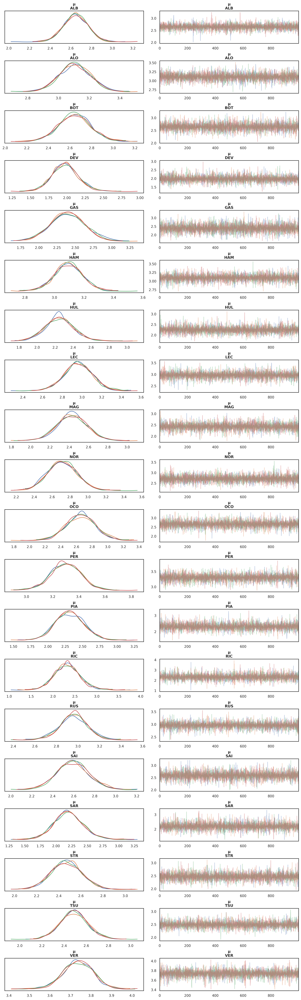

In [1149]:
az.plot_trace(ml_pp_negb_idata, var_names=["μ"], compact=False);

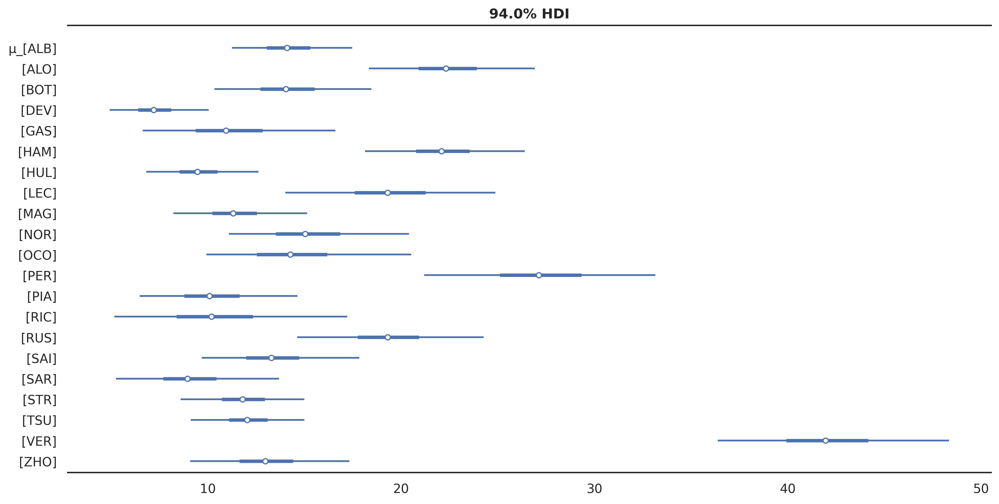

In [1150]:
az.plot_forest(ml_pp_negb_idata, var_names=["μ_"], combined=True, figsize=(12, 6));

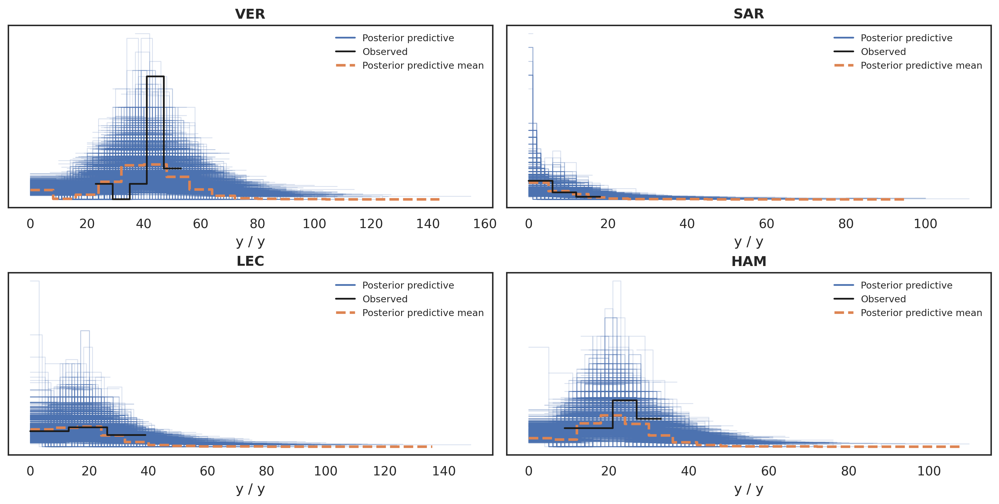

In [1151]:
fig, axs = plt.subplots(2, 2, figsize=(12, 6))

DriverIdx = Enum("Driver", zip(labels.categories, labels.codes))

az.plot_ppc(ml_pp_negb_idata, coords={"idx": [DriverIdx.VER.value]}, ax=axs[0, 0])
axs[0, 0].set_title("VER")

az.plot_ppc(ml_pp_negb_idata, coords={"idx": [DriverIdx.SAR.value]}, ax=axs[0, 1])
axs[0, 1].set_title("SAR")

az.plot_ppc(ml_pp_negb_idata, coords={"idx": [DriverIdx.LEC.value]}, ax=axs[1, 0])
axs[1, 0].set_title("LEC")

az.plot_ppc(ml_pp_negb_idata, coords={"idx": [DriverIdx.HAM.value]}, ax=axs[1, 1])
axs[1, 1].set_title("HAM");

In [1152]:
comparison = az.compare(
    {"unpooled": unpooled_idata, "zero inflated unpooled": zi_unpooled_idata, "hierarchical partially pooled": ml_pp_negb_idata}
)
comparison

/home/kiril/.local/lib/python3.11/site-packages/arviz/stats/stats.py:803: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/home/kiril/.local/lib/python3.11/site-packages/arviz/stats/stats.py:803: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
zero inflated unpooled,0,-771.077381,39.086031,0.000000,0.928117,16.238984,0.000000,True,log
hierarchical partially pooled,1,-771.892072,39.179408,0.814692,0.000000,16.106012,0.581903,True,log
unpooled,2,-826.725467,35.115523,55.648086,0.071883,11.964934,12.171487,False,log


In [1153]:
az.loo(ml_pp_negb_idata)

/home/kiril/.local/lib/python3.11/site-packages/arviz/stats/stats.py:803: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Computed from 4000 posterior samples and 240 observations log-likelihood matrix.

         Estimate       SE
elpd_loo  -771.89    16.11
p_loo       39.18        -

There has been a warning during the calculation. Please check the results.
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.5]   (good)      231   96.2%
 (0.5, 0.7]   (ok)          8    3.3%
   (0.7, 1]   (bad)         1    0.4%
   (1, Inf)   (very bad)    0    0.0%

<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

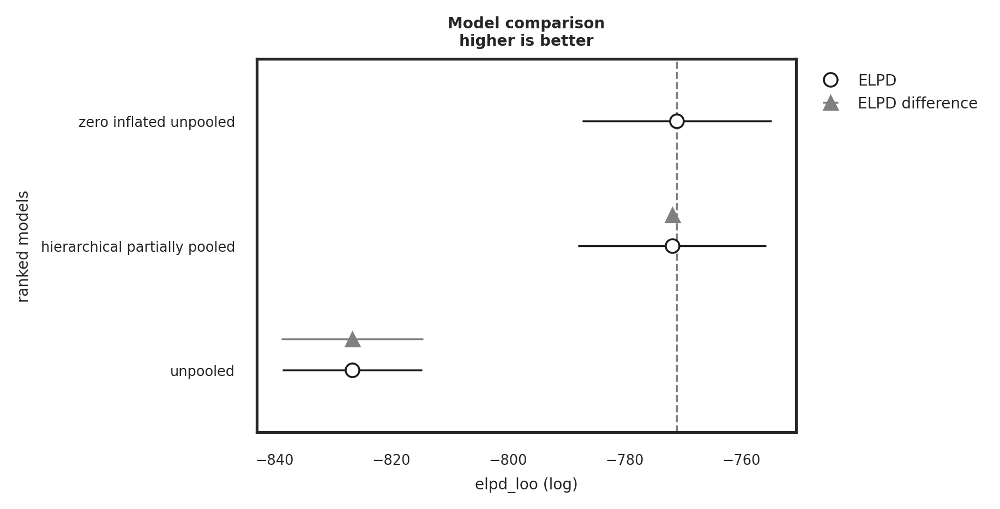

In [1154]:
az.plot_compare(comparison)

### Driver Estimates

Finally, now that we have a (likely) useful model, we can use it to make decisions.

When picking drivers to add/swap into our team, we consider the following:
- how many points per race is the driver expected to bring (and with what variance)
- how likely  is it that a given driver will outperform another driver, and by what magnitude
- how underpriced/overpriced is a a driver given their performance

While price analysis is out of the scope of this notebook, the points estimation model can help us with the first two questions.

Below, we compare each driver to their rivals, using the difference of predicted points per race. To do so, we take the predictions generated from the posterior predictive distribution for each driver, subtract the two vectors, and take the mean. This reduces the posterior distributions to a point estimate, but still incorporates the uncertainty of the model, as we work directly with values generated from the posterior. The value can be seen both as confidence driver x is better than driver y - higher is better, and as the points we expect driver x to earn over driver y on average.

Note that the dataframe isn't symmetric - we are strictly comparing the driver on the X axis to the driver on the Y axis.

In [1155]:
def make_comparison(idata, idx, groups, size=1000):
    columns = {}
    for idx_a, name_a in enumerate(groups):
        for idx_b, name_b in enumerate(groups):
            pp_a = idata.posterior_predictive["y"][:, :, idx == idx_a].values.flatten()
            pp_b = idata.posterior_predictive["y"][:, :, idx == idx_b].values.flatten()

            samples_a = np.random.choice(pp_a, size=size)
            samples_b = np.random.choice(pp_b, size=size)

            if idx_a != idx_b:
                points_over = (samples_a - samples_b).mean()
            else:
                points_over = 0

            columns.setdefault(name_a, []).append(points_over)

    comparison_df = pd.DataFrame.from_dict(columns).set_index(groups)
    mask = np.triu(np.ones_like(comparison_df, dtype=bool))

    return comparison_df, mask

In [1156]:
comparison_df, mask = make_comparison(zi_unpooled_idata, idx, labels)

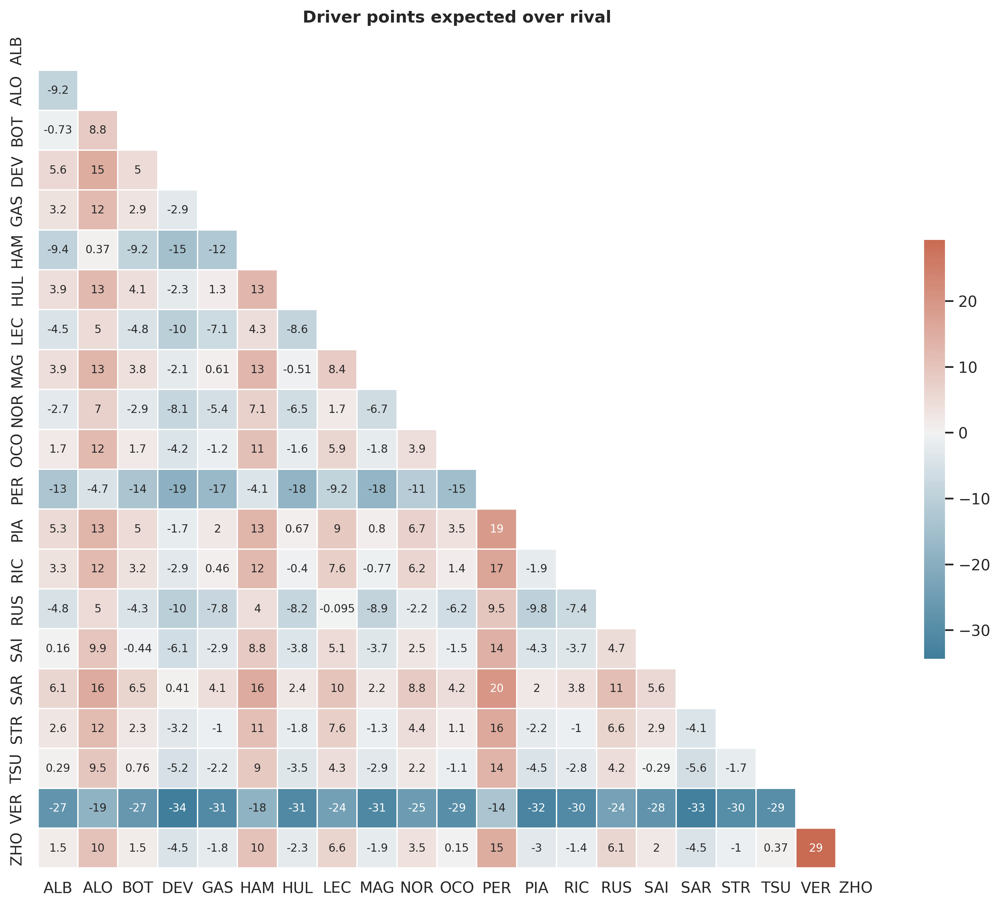

In [1158]:
sns.set_theme(style="white")

cmap = sns.diverging_palette(230, 20, as_cmap=True)

f, ax = plt.subplots(figsize=(11, 9))

ax = sns.heatmap(
    comparison_df,
    cmap=cmap,
    mask=mask,
    annot=True,
    center=0,
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
    annot_kws={"fontsize": 8},
).set(title="Driver points expected over rival");

In [860]:
%load_ext watermark
%watermark -n -u -v -iv

Last updated: Tue Aug 29 2023

Python implementation: CPython
Python version       : 3.11.4
IPython version      : 8.14.0

tqdm             : 4.66.1
numpy            : 1.25.1
pymc_experimental: 0.0.8
pandas           : 2.0.3
sys              : 3.11.4 (main, Jun 28 2023, 19:51:46) [GCC]
seaborn          : 0.12.2
requests         : 2.31.0
preliz           : 0.3.2
scipy            : 1.10.1
arviz            : 0.16.1
pymc             : 5.6.1
json             : 2.0.9
matplotlib       : 3.7.2



In [1778]:
def gamma_exp_decay(t, λ):
    γ = np.exp(np.log(0.5) / λ)
    return γ ** (np.max(t) - t)

In [600]:
filtered_df = data_df[
    data_df["circuit"].isin(["villeneuve", "spa", "silverstone", "hungaroring"])
]

In [601]:
(
    filtered_df[filtered_df["driver"].isin(["TSU", "HUL"])]["driver_points"].sum()
    + filtered_df.groupby(["circuit", "constructor"])
    .first()
    .loc[pd.IndexSlice[:, "haas"], :]["constructor_points"]
    .sum()
)

98.0

In [602]:
(
    filtered_df[filtered_df["driver"].isin(["ALB", "DEV", "RIC"])][
        "driver_points"
    ].sum()
    + filtered_df.groupby(["circuit", "constructor"])
    .first()
    .loc[pd.IndexSlice[:, "mclaren"], :]["constructor_points"]
    .sum()
)

171.0